# HHA550 Diabetes Dataset

## 30 day readmission predicition



In [1]:
# %pip install seaborn
# %pip install missingno
# %pip install xgboost
# %pip install catboost
# %pip install regex
# %pip install sklearn
# %pip install pandas
# %pip install numpy
# %pip install imblearn
# %pip install lightgbm

In [2]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction 

from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler


# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching

# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

In [3]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, balanced_accuracy_score,\
                            precision_score, recall_score, roc_auc_score,\
                            plot_confusion_matrix, classification_report, plot_roc_curve, f1_score

import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

import warnings
warnings.filterwarnings("ignore")

* If from imblearn.oversampling import SMOTE does not load use
    `conda install -c conda-forge imbalanced-learn`
* Then rerun
    `from imblearn.over_sampling import SMOTE`

# Exploratory Data Analysis (EDA)

## Start with Loading the CSV Data

In [4]:

diabetes = pd.read_csv('clean_diabetic_data.csv')
diabetes.dtypes

Unnamed: 0                    int64
encounter_id                  int64
patient_nbr                   int64
race                          int64
gender                        int64
age                           int64
admission_type_id             int64
discharge_disposition_id      int64
admission_source_id           int64
time_in_hospital              int64
medical_specialty           float64
num_lab_procedures            int64
num_procedures                int64
num_medications               int64
number_outpatient             int64
number_emergency              int64
number_inpatient              int64
diag_1                       object
diag_2                       object
diag_3                       object
number_diagnoses              int64
max_glu_serum                 int64
A1Cresult                     int64
metformin                     int64
repaglinide                   int64
nateglinide                   int64
chlorpropamide                int64
glimepiride                 

In [5]:
diabetes.head()

,Unnamed: 0,encounter_id,patient_nbr,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,0,2278392,8222157,1,2,10,6,25,1,1,...,0,0,0,0,0,0,0,0,0,0
1,1,149190,55629189,1,2,20,1,1,7,3,...,0,10,0,0,0,0,0,1,1,0
2,2,64410,86047875,2,2,30,1,1,7,2,...,0,0,0,0,0,0,0,0,1,0
3,3,500364,82442376,1,1,40,1,1,7,2,...,0,10,0,0,0,0,0,1,1,0
4,4,16680,42519267,1,1,50,1,1,7,1,...,0,1,0,0,0,0,0,1,1,0


# Exploring and Understanding the Data


### Initial Insights
* That makes it a lot easier to compare the missing value percentages within the columns.
* In our dataset, we have both numerical and categorical variables.
* It is essential to see whether columns are correctly inferred.
* The most important one to look for is our target variable 'stroke'
* 'Stroke' is detected as an integer, not as an object.
* Target variable is coded as 1 for positive cases (has a stroke) and 0 for negative cases (does not have a stroke)
* Both 'Hypertension' and 'heart disease" are detected as an integer, not as an object.
* Just remember from the data definition part, they are coded as 1 for the positive cases(has hypertension/heart disease)
* And 0 for the negative cases (does not have hypertension/heart disease)
* We don't need to change them, but it is good to see and be aware of it.
* In addition to them, we have 3 categorical variables, which we have to encode as numerical

**Note: In this case we do not need to know the exact missing percentage of the columns.**

# What are the current problems we have that need to be solved?
* We have binary classification problem.
* We make prection on the target variable `30 day readmission`
* And we will build a model to get best prediction on the readmission variable.

## Insights into our target variable
* One of the first steps of exploratory data analysis should always be to look at what the values of y look like.

In [6]:
y = diabetes['readmitted']
print(f'Percentage of patient had a readmission: % {round(y.value_counts(normalize=True)[1]*100,2)} --> ({y.value_counts()[1]} patient)\nPercentage of patient did not have a readmission: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[0]} patient)')

Percentage of patient had a readmission: % 11.16 --> (11357 patient)
Percentage of patient did not have a readmission: % 88.84 --> (90409 patient)


### So what does that all mean?
We have imbalanced data

* 11.16% of the instances of our target variable is `30 day readmissions`
* 11357 patients readmitted within 30 days
* 88.84% of the instances of our target variable is `no readmission or readmission over 30 days`
* 90409 patients did not readmit within 30 days.

### Visualize Readmission

In [7]:
fig = px.histogram(diabetes, x="readmitted", title='Readmitted within 30 days', width=400, height=400)
fig.show()

## Data Imbalance

* Instances across classes are imbalanced, like in our dataset, we have imbalance data.

* The problem is, most of the machine learning algorithm do not work well with the imbalanced data.

* Some of the metrics (like accuracy) give us misleading results.

* Most of the time in classification problems our interest is to get better predict on the minority class.

* In our example: People had a stroke is minority class.

* Otherwise our machine learning algorithm falsely predicts majority class.

* In our example: No stroke is majority class

## Decide on Metrics

* This is the first step when approaching a machine learning problem: decide the metric!

* The choice of the wrong metric can mean choosing the wrong algorithm.

* We see that the target is skewed and thus the best metric for this binary classification problem would be Area Under the ROC Curve (AUC).

* We can use precision and recall too, but AUC combines these two metrics.

* We have already seen the label/target distribution, and we know that it is a binary classification problem with skewed targets. Thus, we will be using StratifiedKFold to split the data

* Just for further info, it is not advisable to use accuracy as an evaluation metric, when dealing with higly imbalanced data

In [8]:
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 49 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Unnamed: 0                101766 non-null  int64  
 1   encounter_id              101766 non-null  int64  
 2   patient_nbr               101766 non-null  int64  
 3   race                      101766 non-null  int64  
 4   gender                    101766 non-null  int64  
 5   age                       101766 non-null  int64  
 6   admission_type_id         101766 non-null  int64  
 7   discharge_disposition_id  101766 non-null  int64  
 8   admission_source_id       101766 non-null  int64  
 9   time_in_hospital          101766 non-null  int64  
 10  medical_specialty         101766 non-null  float64
 11  num_lab_procedures        101766 non-null  int64  
 12  num_procedures            101766 non-null  int64  
 13  num_medications           101766 non-null  i

### Check for Missing Data / Missing Values

In [9]:
def missing (diabetes):
    missing_number = diabetes.isnull().sum().sort_values(ascending=False)
    missing_percent = (diabetes.isnull().sum()/diabetes.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values

missing(diabetes)

,Missing_Number,Missing_Percent
Unnamed: 0,0,0.0
nateglinide,0,0.0
glimepiride,0,0.0
acetohexamide,0,0.0
glipizide,0,0.0
glyburide,0,0.0
tolbutamide,0,0.0
pioglitazone,0,0.0
rosiglitazone,0,0.0
acarbose,0,0.0


<AxesSubplot:>

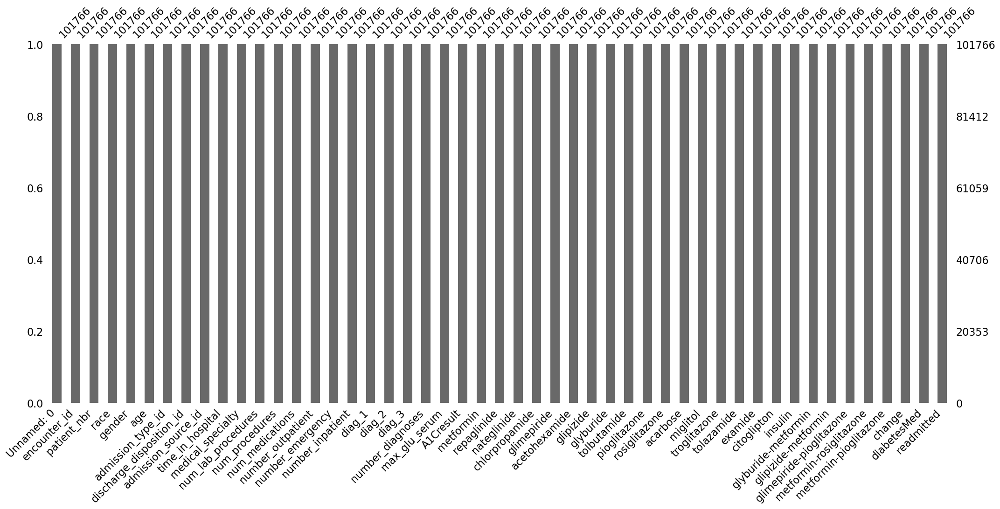

In [10]:
# Visualizing the missing data to get more idea
msno.bar(diabetes)

<AxesSubplot:>

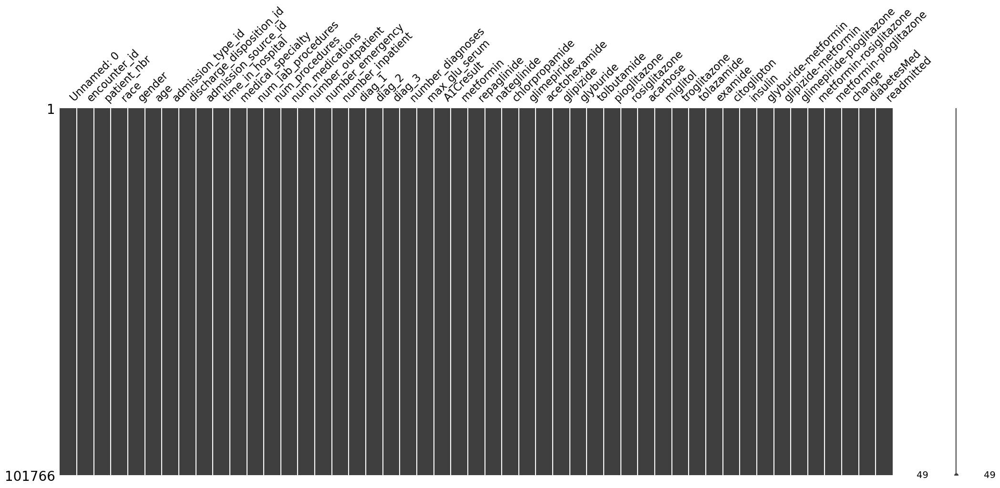

In [11]:
msno.matrix(diabetes)

* We have no missing values in our dataset

# Numerical Features
* Look at the data elements (columns) using `diabetes.head()`
* Look at the Dtype (data type) using `diabetes.info()`

In [12]:
diabetes.head()

,Unnamed: 0,encounter_id,patient_nbr,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,0,2278392,8222157,1,2,10,6,25,1,1,...,0,0,0,0,0,0,0,0,0,0
1,1,149190,55629189,1,2,20,1,1,7,3,...,0,10,0,0,0,0,0,1,1,0
2,2,64410,86047875,2,2,30,1,1,7,2,...,0,0,0,0,0,0,0,0,1,0
3,3,500364,82442376,1,1,40,1,1,7,2,...,0,10,0,0,0,0,0,1,1,0
4,4,16680,42519267,1,1,50,1,1,7,1,...,0,1,0,0,0,0,0,1,1,0


In [13]:
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 49 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Unnamed: 0                101766 non-null  int64  
 1   encounter_id              101766 non-null  int64  
 2   patient_nbr               101766 non-null  int64  
 3   race                      101766 non-null  int64  
 4   gender                    101766 non-null  int64  
 5   age                       101766 non-null  int64  
 6   admission_type_id         101766 non-null  int64  
 7   discharge_disposition_id  101766 non-null  int64  
 8   admission_source_id       101766 non-null  int64  
 9   time_in_hospital          101766 non-null  int64  
 10  medical_specialty         101766 non-null  float64
 11  num_lab_procedures        101766 non-null  int64  
 12  num_procedures            101766 non-null  int64  
 13  num_medications           101766 non-null  i

In [14]:
diabetes.columns

Index(['Unnamed: 0', 'encounter_id', 'patient_nbr', 'race', 'gender', 'age',
       'admission_type_id', 'discharge_disposition_id', 'admission_source_id',
       'time_in_hospital', 'medical_specialty', 'num_lab_procedures',
       'num_procedures', 'num_medications', 'number_outpatient',
       'number_emergency', 'number_inpatient', 'diag_1', 'diag_2', 'diag_3',
       'number_diagnoses', 'max_glu_serum', 'A1Cresult', 'metformin',
       'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride',
       'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone',
       'tolazamide', 'examide', 'citoglipton', 'insulin',
       'glyburide-metformin', 'glipizide-metformin',
       'glimepiride-pioglitazone', 'metformin-rosiglitazone',
       'metformin-pioglitazone', 'change', 'diabetesMed', 'readmitted'],
      dtype='object')

In [15]:
categorical = ['gender', 'race', 'admission_type_id']

numerical = ['age','A1Cresult', 'number_diagnoses', 'num_medications', 'num_lab_procedures', 'time_in_hospital']

In [16]:
diabetes[numerical].describe()

,age,A1Cresult,number_diagnoses,num_medications,num_lab_procedures,time_in_hospital
count,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000
mean,70.967022,0.957117,7.422607,16.021844,43.095641,4.395987
std,15.940838,2.476990,1.933600,8.127566,19.674362,2.985108
min,10.000000,0.000000,1.000000,1.000000,1.000000,1.000000
25%,60.000000,0.000000,6.000000,10.000000,31.000000,2.000000
50%,70.000000,0.000000,8.000000,15.000000,44.000000,4.000000
75%,80.000000,0.000000,9.000000,20.000000,57.000000,6.000000
max,100.000000,8.000000,16.000000,81.000000,132.000000,14.000000


* We have six numerical features in our dataset.

* All of our numerical features are measured in different scales.

* Many machine learning algorithms perform better standard range scaled numerical variables (such as Linear models,artificial neural networks, K-nearest Neighbors,support vector machines, etc.)

* Tree models (such as, decision trees,random forest, etc.) work fine with different range numerical features.

### Skewness

In [17]:
diabetes[numerical].skew()

age                  -0.630539
A1Cresult             2.351736
number_diagnoses     -0.876746
num_medications       1.326672
num_lab_procedures   -0.236544
time_in_hospital      1.133999
dtype: float64

* Based on the result, age, number_diagnoses & num_lab_procedures has slight left skew (negative), other three features have right tail (positively) skewed shape distribution.

### Univariate Analysis

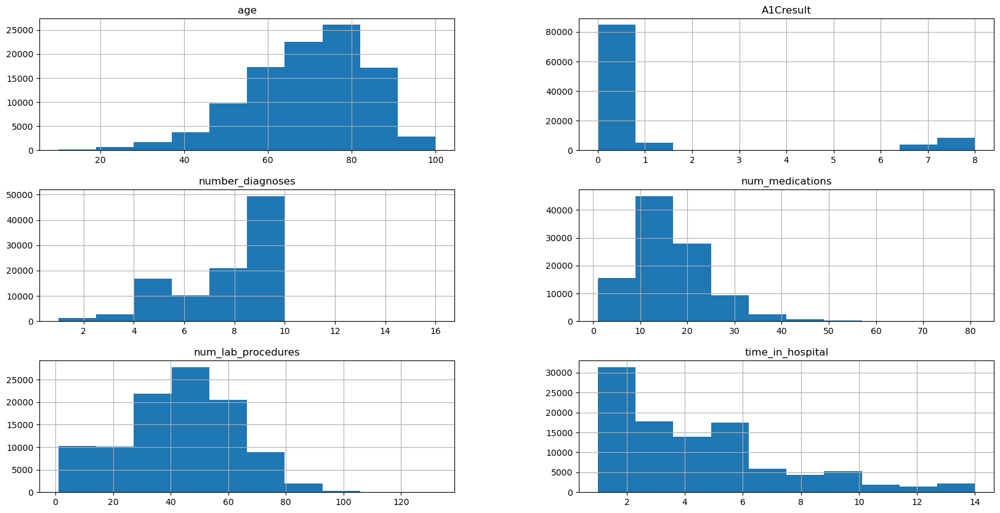

In [18]:
diabetes[numerical].hist(figsize=(20,10));

* As seen in both skewness result and histograms, numerical features have skewness in different degrees
* We will deal with different scale and skewness during the modeling by using standardization `Standard scaler`

# Categorical Feautres
* Gender
* Race
* Admission type ID


GENDER

In [19]:
print (f'{round(diabetes["gender"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="gender", title='Gender', width=500, height=500)
fig.show()

2    53.76
1    46.24
0     0.00
Name: gender, dtype: float64


- Unknown/Invalid - 0
- Male = 1
- Female = 2

Race

In [20]:
print (f'{round(diabetes["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="race", title='Race', width=500, height=500)
fig.show()

1    74.78
2    18.88
0     2.23
3     2.00
5     1.48
4     0.63
Name: race, dtype: float64


- ? = 0
- Caucasian = 1
- AfricanAmerican = 2
- Hispanic = 3
- Asian = 4
- Other = 5

Hospital admission type ID

In [21]:
print (f'{round(diabetes["admission_type_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="admission_type_id", title='Admission Type ID', width=500, height=500)
fig.show()

1    53.05
3    18.54
2    18.16
6     5.20
5     4.70
8     0.31
7     0.02
4     0.01
Name: admission_type_id, dtype: float64


- Emergency = 1
- Urgent = 2
- Elective = 3
- Newborn = 4
- Not Available = 5
- NULL = 6
- Trauma Center = 7
- Not Mapped = 8

# Bivariate Analysis

### Gender & Readmission

In [22]:
fig = px.histogram(diabetes, x="gender", color="readmitted",width=600, height=400)
fig.show()

- Unknown/Invalid - 0
- Male = 1
- Female = 2

Females are more likely to readmit 

### Race & Readmission

In [23]:
fig = px.histogram(diabetes, x="race", color="readmitted",width=600, height=600)
fig.show()

- ? = 0
- Caucasian = 1
- AfricanAmerican = 2
- Hispanic = 3
- Asian = 4
- Other = 5

Caucasian patients are more likely to readmit followed by African Americans

### Admission Type & Diabetes

In [24]:
fig = px.histogram(diabetes, x="admission_type_id", color="readmitted",width=600, height=600)
fig.show()

- Emergency = 1
- Urgent = 2
- Elective = 3
- Newborn = 4
- Not Available = 5
- NULL = 6
- Trauma Center = 7
- Not Mapped = 8

Patients who were admitted as an emergency encounter are more likely to readmit

## Metrics of Importance

* The degree of dependency between a categorical variable and the target variable can be measured by using a mutual info score
* Higher values of mutual information mean a higher degree of dependence
* A higher mutual info score implies that we can get a better prediction on the target variable

In [25]:
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, diabetes['readmitted']) 

stroke_cat = diabetes[categorical].apply(cat_mut_inf) 
stroke_cat = stroke_cat.sort_values(ascending=False).to_frame(name='mutual_info_score') 
stroke_cat

,mutual_info_score
admission_type_id,0.000145
race,0.000136
gender,0.000008


* As seen above, most of the categorical variables have almost no effect on the target variable.
* It would be a good exercise to see the differences on the model between with and without the some of the categorical variables. For the sake of the first study, we will keep the categorical variables in the model

### Correlation Matrix & Scatter Plots

In [26]:
diabetes[numerical].corr()

,age,A1Cresult,number_diagnoses,num_medications,num_lab_procedures,time_in_hospital
age,1.000000,-0.134667,0.242597,0.041847,0.020770,0.107515
A1Cresult,-0.134667,1.000000,-0.031897,0.014699,0.222759,0.051855
number_diagnoses,0.242597,-0.031897,1.000000,0.261526,0.152773,0.220186
num_medications,0.041847,0.014699,0.261526,1.000000,0.268161,0.466135
num_lab_procedures,0.020770,0.222759,0.152773,0.268161,1.000000,0.318450
time_in_hospital,0.107515,0.051855,0.220186,0.466135,0.318450,1.000000


There is a very small positive correlation between numerical features.
Let us see their mean scores with the target variable

In [27]:
diabetes.groupby('readmitted')[numerical].mean()

,age,A1Cresult,number_diagnoses,num_medications,num_lab_procedures,time_in_hospital
readmitted,,,,,,
0,70.867392,0.970600,7.388667,15.911137,42.953644,4.349224
1,71.760148,0.849784,7.692789,16.903143,44.226028,4.768249


- NO = 0
- (<30) = 1

And the correlation with the target variable

In [28]:
diabetes[['age','A1Cresult','number_diagnoses','num_medications', 'num_lab_procedures', 'time_in_hospital']].corr()

,age,A1Cresult,number_diagnoses,num_medications,num_lab_procedures,time_in_hospital
age,1.000000,-0.134667,0.242597,0.041847,0.020770,0.107515
A1Cresult,-0.134667,1.000000,-0.031897,0.014699,0.222759,0.051855
number_diagnoses,0.242597,-0.031897,1.000000,0.261526,0.152773,0.220186
num_medications,0.041847,0.014699,0.261526,1.000000,0.268161,0.466135
num_lab_procedures,0.020770,0.222759,0.152773,0.268161,1.000000,0.318450
time_in_hospital,0.107515,0.051855,0.220186,0.466135,0.318450,1.000000


### On to the Scatter Plots

#### Age & Number of Diagnoses

In [29]:
fig = px.scatter(diabetes, x='age', y='number_diagnoses', title='Age & Number of Diagnoses ',color='readmitted', hover_data = diabetes[['readmitted']])
fig.show()

#### Age & A1Crest

In [30]:
fig = px.scatter(diabetes, y='A1Cresult', x='age', title='Age & A1Cresult',color='readmitted', hover_data = diabetes[['readmitted']])
fig.show()

#### A1Cresult & Number of Medications

In [31]:
fig = px.scatter(diabetes, y='num_medications', x='A1Cresult', title='A1Cresult & Number of Medications ',color='readmitted', hover_data = diabetes[['readmitted']])
fig.show()

### Step 1: Drop the columns that are either missing most of the times or are not relevant
* The `id` is an identifier to uniquely identify the visit of a patient in a hospital. Each of the rows are individual instances. Also, there is no importance of this variable from prediction point to of view and hence it would be wise to drop this too.

In [32]:
# Dropping the columns which are not required
diabetes.drop(['Unnamed: 0', 'encounter_id', 'patient_nbr', 'race', 'gender', 'age',
       'admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'medical_specialty',
       'num_procedures', 'number_outpatient',
       'number_emergency', 'number_inpatient', 'diag_1', 'diag_2', 'diag_3',
       'max_glu_serum', 'A1Cresult', 'metformin',
       'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride',
       'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone',
       'tolazamide', 'examide', 'citoglipton', 'insulin',
       'glyburide-metformin', 'glipizide-metformin',
       'glimepiride-pioglitazone', 'metformin-rosiglitazone',
       'metformin-pioglitazone', 'change', 'diabetesMed'], axis = 1, inplace = True)

In [33]:
# Lets see what we just did
diabetes.head()

,time_in_hospital,num_lab_procedures,num_medications,number_diagnoses,readmitted
0,1,41,1,1,0
1,3,59,18,9,0
2,2,11,13,6,0
3,2,44,16,7,0
4,1,51,8,5,0


# Breaking the data up into Train & Test

In [34]:
train_df, valid_df, test_df = np.split(diabetes.sample(frac=1, random_state=42), 
                                       [int(.7*len(diabetes)), int(0.85*len(diabetes))])
train_df = train_df.reset_index(drop = True)
valid_df = valid_df.reset_index(drop = True)
test_df = test_df.reset_index(drop = True)

In [35]:
diabetes.readmitted.value_counts()

0    90409
1    11357
Name: readmitted, dtype: int64

In [36]:
train_df.readmitted.value_counts()

0    63275
1     7961
Name: readmitted, dtype: int64

In [37]:
valid_df.readmitted.value_counts()

0    13520
1     1745
Name: readmitted, dtype: int64

In [38]:
test_df.readmitted.value_counts()

0    13614
1     1651
Name: readmitted, dtype: int64

# Treating the Imbalance in the Data

Imbalance in the data means that one of the classes in the data is too less as compared to the others. Typically, it is better to balance the data in some way to give the positives more weight. There are 3 strategies that are typically utilized:

* Sub-sample the more dominant class: use a random subset of the negatives
* Over-sample the imbalanced class: use the same positive samples multiple times
* Create synthetic positive data

Usually, you will want to use the latter two methods if you only have a handful of positive cases. Since we have a few thousand positive cases, let's use the sub-sample approach. Here, we will create a balanced training data set that has 50% positive and 50% negative. You can also play with this ratio to see if you can get an improvement.

In [39]:
def calc_prevalence(y_actual):
    
    '''
    This function is to understand the ratio/distribution of the classes that we are going to predict for.
    
    Params:
    1. y_actual: The target feature
    
    Return:
    1. (sum(y_actual)/len(y_actual)): The ratio of the postive class in the comlpete data.
    '''
    
    return (sum(y_actual)/len(y_actual))

In [1]:
# split the training data into positive and negative
rows_pos = train_df.readmitted == 2
df_train_pos = train_df.loc[rows_pos]
df_train_neg = train_df.loc[~rows_pos]

# merge the balanced data
stroke_df_balanced = pd.concat([df_train_pos, df_train_neg.sample(n = len(df_train_pos), random_state = 111)],axis = 0)

# shuffle the order of training samples 
stroke_df_balanced = stroke_df_balanced.sample(n = len(stroke_df_balanced), random_state = 42).reset_index(drop = True)

print('Train balanced prevalence(n = %d):%.3f'%(len(stroke_df_balanced), \
                                                calc_prevalence(stroke_df_balanced.readmitted.values)))

NameError: name 'train_df' is not defined

In [41]:
stroke_df_balanced.readmitted.value_counts()

1    7961
0    7961
Name: readmitted, dtype: int64

In [42]:
X_train = stroke_df_balanced.drop('readmitted',axis=1)

y_train = stroke_df_balanced['readmitted']

X_valid = valid_df.drop('readmitted',axis=1)

y_valid = valid_df['readmitted']

X_test = test_df.drop('readmitted',axis=1)

y_test = test_df['readmitted']

In [43]:
scaler=StandardScaler()
X_train[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses']] = pd.DataFrame(scaler.fit_transform(X_train[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses'])
X_valid[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses']] = pd.DataFrame(scaler.transform(X_valid[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses'])
X_test[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses']] = pd.DataFrame(scaler.transform(X_test[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses'])

# Creating and Understanding Models

In [44]:
def calc_specificity(y_actual, y_pred, thresh):
    # calculates specificity
    return sum((y_pred < thresh) & (y_actual == 0)) /sum(y_actual ==0)

def print_report(y_actual, y_pred, thresh = 0.5):
    
    '''
    This function calculates all the metrics to asses the machine learning models.
    
    Params:
    1. y_actual: The actual values for the target variable.
    2. y_pred: The predicted values for the target variable.
    3. thresh: The threshold for the probability to be considered as a positive class. Default value 0.5
    
    Return:
    1. AUC
    2. Accuracy
    3. Recall
    4. Precision
    5. Specificity
    '''
    
    auc = roc_auc_score(y_actual, y_pred)
    accuracy = accuracy_score(y_actual, (y_pred > thresh))
    recall = recall_score(y_actual, (y_pred > thresh))
    precision = precision_score(y_actual, (y_pred > thresh))
    specificity = calc_specificity(y_actual, y_pred, thresh)
    print('AUC:%.3f'%auc)
    print('accuracy:%.3f'%accuracy)
    print('recall:%.3f'%recall)
    print('precision:%.3f'%precision)
    print('specificity:%.3f'%specificity)
    print('prevalence:%.3f'%calc_prevalence(y_actual))
    print(' ')
    return auc, accuracy, recall, precision, specificity

In [45]:
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 5 columns):
 #   Column              Non-Null Count   Dtype
---  ------              --------------   -----
 0   time_in_hospital    101766 non-null  int64
 1   num_lab_procedures  101766 non-null  int64
 2   num_medications     101766 non-null  int64
 3   number_diagnoses    101766 non-null  int64
 4   readmitted          101766 non-null  int64
dtypes: int64(5)
memory usage: 3.9 MB


## Linear Regression

In [46]:
lnr = LinearRegression()
lnr.fit(X_train, y_train)


y_valid_preds = lnr.predict(X_valid)

In [47]:
y_valid_preds

array([0.51068724, 0.40739556, 0.55946658, ..., 0.48536316, 0.36597555,
       0.55233447])

## Logistic Regression

In [48]:
lr=LogisticRegression(random_state = 42, solver = 'newton-cg', max_iter = 200)
lr.fit(X_train, y_train)

y_valid_preds = lr.predict_proba(X_valid)[:,1]

print('Metrics for Validation data:')

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,y_valid_preds, 0.5)

Metrics for Validation data:
AUC:0.549
accuracy:0.506
recall:0.579
precision:0.129
specificity:0.497
prevalence:0.114
 


## KNN Model

In [50]:
knn = KNeighborsClassifier(n_neighbors = 100)
knn.fit(X_train, y_train)

knn_preds = knn.predict_proba(X_valid)[:,1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,knn_preds, 0.5)

AUC:0.547
accuracy:0.507
recall:0.567
precision:0.128
specificity:0.454
prevalence:0.114
 


## Stochastic Gradient Descent Model

In [51]:
sgdc=SGDClassifier(loss = 'log',alpha = 0.1,random_state = 42)
sgdc.fit(X_train, y_train)

sgd_preds = sgdc.predict_proba(X_valid)[:,1]

print('Stochastic Gradient Descent')
print('Validation:')
sgdc_valid_auc, sgdc_valid_accuracy, sgdc_valid_recall, \
                sgdc_valid_precision, sgdc_valid_specificity = print_report(y_valid,sgd_preds, 0.5)

Stochastic Gradient Descent
Validation:
AUC:0.550
accuracy:0.524
recall:0.564
precision:0.131
specificity:0.518
prevalence:0.114
 


## Decision Tree

In [52]:
dc_clf = DecisionTreeClassifier(random_state=42, max_depth = 10)
dc_clf.fit(X_train, y_train)

dc_preds_proba = dc_clf.predict_proba(X_valid)[:,1]
dc_preds = dc_clf.predict(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,dc_preds_proba, 0.5)

AUC:0.527
accuracy:0.427
recall:0.648
precision:0.122
specificity:0.386
prevalence:0.114
 


## Random Forest

In [53]:
rf_clf = RandomForestClassifier(random_state=111, max_depth = 6)

rf_clf.fit(X_train, y_train)

rf_preds = rf_clf.predict(X_valid)
rf_preds_proba = rf_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,rf_preds_proba, 0.5)

AUC:0.553
accuracy:0.489
recall:0.604
precision:0.129
specificity:0.474
prevalence:0.114
 


## Linear SVC

In [54]:
lsvc_clf = LinearSVC(random_state=111)
lsvc_clf.fit(X_train, y_train)

lsvc_preds = lsvc_clf.decision_function(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,lsvc_preds, 0.5)

AUC:0.549
accuracy:0.886
recall:0.000
precision:0.000
specificity:1.000
prevalence:0.114
 


## Gradient Boosting Model

In [55]:
gb_clf = GradientBoostingClassifier(n_estimators = 100, criterion='friedman_mse', learning_rate = 1.0, max_depth = 3,\
                                    random_state = 111)

gb_clf.fit(X_train, y_train)
gb_preds = gb_clf.predict(X_valid)
gb_preds_proba = gb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,gb_preds_proba, 0.5)

AUC:0.540
accuracy:0.485
recall:0.579
precision:0.124
specificity:0.473
prevalence:0.114
 


## XGB Model

In [56]:
xgb_clf = xgb.XGBClassifier(max_depth=3, learning_rate = 1.0, use_label_encoder = False,\
                            eval_metric = 'logloss')
xgb_clf.fit(X_train, y_train)

xgb_preds = xgb_clf.predict(X_valid)
xgb_preds_proba = xgb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,xgb_preds_proba, 0.5)

AUC:0.542
accuracy:0.499
recall:0.566
precision:0.125
specificity:0.490
prevalence:0.114
 


## Catboost Model

In [57]:
catb=CatBoostClassifier(iterations=200, depth=3, learning_rate=1.0, random_state = 111)
catb.fit(X_train, y_train)
catb_preds = catb.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,catb_preds, 0.5)

0:	learn: 0.6878935	total: 60.5ms	remaining: 12s
1:	learn: 0.6866173	total: 63.3ms	remaining: 6.27s
2:	learn: 0.6859676	total: 65.4ms	remaining: 4.29s
3:	learn: 0.6851756	total: 67.6ms	remaining: 3.31s
4:	learn: 0.6847650	total: 69.5ms	remaining: 2.71s
5:	learn: 0.6843580	total: 71.5ms	remaining: 2.31s
6:	learn: 0.6843053	total: 73.1ms	remaining: 2.02s
7:	learn: 0.6840379	total: 75ms	remaining: 1.8s
8:	learn: 0.6833850	total: 76.4ms	remaining: 1.62s
9:	learn: 0.6833009	total: 78.2ms	remaining: 1.49s
10:	learn: 0.6828936	total: 80.1ms	remaining: 1.38s
11:	learn: 0.6825560	total: 82ms	remaining: 1.28s
12:	learn: 0.6818466	total: 83.7ms	remaining: 1.2s
13:	learn: 0.6812720	total: 85.5ms	remaining: 1.14s
14:	learn: 0.6808288	total: 87.1ms	remaining: 1.07s
15:	learn: 0.6803013	total: 88.8ms	remaining: 1.02s
16:	learn: 0.6800877	total: 90.6ms	remaining: 975ms
17:	learn: 0.6797286	total: 92.5ms	remaining: 935ms
18:	learn: 0.6793484	total: 94ms	remaining: 895ms
19:	learn: 0.6788150	total: 95.8

# Hyper Parameter Tuning

* From the above models we will choose two models for demonstration i.e. Random Forest, Decision Trees for hyper-parameter tuning.
* Generally you can pick up the top three models based on the 'AUC', 'Recall' or 'F1 score' score and tune them.

There are many techniques for hyper-parameter tuning:

* Random Search
* Grid Search
* Halving Grid Search(added recently in sklearn)

Special Note:
* It will take significant time to run Hyper Parameter Tuning 
* Timing will depend on available resources of server

In [58]:
recall_scoring = make_scorer(recall_score)

## Decision Tree - Hyper Parameter Tuning

In [59]:
dc_grid = {'max_features':['auto','sqrt'], # maximum number of features to use at each split
           'max_depth':range(1,11,1), # maximum depth of the tree
           'min_samples_split':range(2,10,2), # minimum number of samples to split a node
           'criterion':['gini','entropy']} # criterion for evaluating a split

dc_random = RandomizedSearchCV(estimator = dc_clf, param_distributions = dc_grid, 
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

dc_random.fit(X_train, y_train)

dc_random.best_params_

dc_hp_preds = dc_random.best_estimator_.predict(X_valid)
dc_hp_preds_proba = dc_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, dc_hp_preds_proba)

Fitting 2 folds for each of 20 candidates, totalling 40 fits


0.5360083331920448

In [60]:
recall_score(y_valid, dc_hp_preds)

0.6905444126074498

## Random Forest - Hyper Parameter Tuning

In [61]:
rf_grid = {'n_estimators':range(200,1000,200), # number of trees
           'max_features':['auto','sqrt'], # maximum number of features to use at each split
           'max_depth':range(1,11,1), # maximum depth of the tree
           'min_samples_split':range(2,10,2), # minimum number of samples to split a node
           'criterion':['gini','entropy']} # criterion for evaluating a split

rf_random = RandomizedSearchCV(estimator = rf_clf, param_distributions = rf_grid, 
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

rf_random.fit(X_train, y_train)

rf_random.best_params_

rf_hp_preds = rf_random.best_estimator_.predict(X_valid)
rf_hp_preds_proba = rf_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, rf_hp_preds_proba)

Fitting 2 folds for each of 20 candidates, totalling 40 fits


0.5517946245401061

In [62]:
recall_score(y_valid, rf_hp_preds)

0.6263610315186247

## XGBoost - Hyper Parameter Tuning

In [63]:
xgb_grid = params = {
        'min_child_weight': [1, 5, 8, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 0.9, 1.0],
        'max_depth': [3, 4, 5]
        } # criterion for evaluating a split

xgb_random = GridSearchCV(estimator = xgb_clf, param_grid = xgb_grid, 
                               cv = 2, scoring = recall_scoring,
                               verbose = 1)

xgb_random.fit(X_train, y_train)

xgb_random.best_params_

xgb_hp_preds = xgb_random.best_estimator_.predict(X_valid)
xgb_hp_preds_proba = xgb_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, xgb_hp_preds_proba)

Fitting 2 folds for each of 720 candidates, totalling 1440 fits


0.5403912488767569

In [64]:
recall_score(y_valid, xgb_hp_preds)

0.6607449856733524